# AU Encoding

### sub 04 & 13

### AU enc

In [98]:
import sys
sys.path.append('/home/c10370862/FEED_new/scripts/')
import encoding as enc
from sklearn.linear_model import Ridge
from nistats.first_level_model import FirstLevelModel
import numpy as np
from nilearn.masking import apply_mask, unmask
from sklearn.model_selection import GroupKFold
from nilearn import plotting
import nibabel as nib

In [99]:
subjects = ['04','13']
task = 'expressive'
space = 'T1w'
filt = ['face']
conf_cols = ['cosine00','cosine01', 
             'trans_x','trans_y','trans_z',
             'rot_x','rot_y','rot_z','csf', 'white_matter']

In [100]:
lambda_val = 1
clf = Ridge(alpha = lambda_val,
            normalize = False)

create single trial estimates

In [101]:
models_imgs = []
models_events = []
models_conf = []
rsq_imgs = []
single_trial_zscores = []

#loop over subjects and load files
for sub_idx,sub in enumerate(subjects):
    imgs, events, conf, mask, json = enc.load_and_create_obj(sub,task,space,
                                                             mask='brain',
                                                             skip_missing=True)
    models_imgs.append(imgs)
    
    #filter events and select confounds
    events = enc.filter_event_type(events,filt,keep=True)
    for idx, e in enumerate(events):
        e = e[e.data_split == 'train']
        trial_names = []
        for t in range(e.shape[0]):
            trial_names.append('trial ' + str(t))
        e.trial_type = trial_names
        events[idx] = e
    models_events.append(events)
    
    for idx, c in enumerate(conf):
        conf[idx] = c.loc[:, conf_cols]
        models_conf.append(conf)
    
    #initialize model and arguments
    n_runs = len(imgs)
    n_trials = len(trial_names)
    n_vox = int(np.sum(nib.load(mask).get_data()))
    AU_cols = [col for col in events[0].columns if 'AU' in col and col != 'N_AUs']
    
    AU_array_all = np.zeros((n_runs,n_trials,len(AU_cols)))
    z_array_all = np.zeros((n_runs,n_trials,n_vox))
    tr = json.RepetitionTime[0]
    
    model = FirstLevelModel(t_r=tr,
                            hrf_model='glover + derivative',
                            drift_model=None,
                            smoothing_fwhm=3,
                            mask = mask,
                            verbose=0,
                            n_jobs=10
                           )
    
    #fit single trials
    for run_idx, run in enumerate(imgs):
        print('fitting run %i out of %i runs for subject %s' %(run_idx+1, n_runs, sub))
        model.fit(run, events[run_idx], conf[run_idx])
        zscore = np.zeros((n_trials, n_vox))
        print('processing single trial z-scores')
        for trial_ind, trial in enumerate(trial_names):
            z = model.compute_contrast(trial, output_type = 'z_score')
            z = apply_mask(z, model.mask_img)
            z_array_all[run_idx, trial_ind,:] = z
        AU_array_all[run_idx,:,:] = models_events[sub_idx][run_idx].loc[:,AU_cols].values
    single_trial_zscores.append(z_array_all)
    
    #calc rsq
    X = np.vstack(AU_array_all)
    y = np.vstack(z_array_all)
    y_hat = np.zeros_like(y)
    groups = np.repeat(range(1,n_runs+1), n_trials)
    group_kfold = GroupKFold(n_splits=n_runs)

    for train_idx, test_idx in group_kfold.split(X, y, groups):
        clf.fit(X[train_idx], y[train_idx])
        y_hat[test_idx] = clf.predict(X[test_idx])

    rsq = enc.rsq_calc(y, y_hat)
    rsq[rsq < 0] = 0
    rsq_imgs.append(unmask(rsq, model.mask_img))

('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-3_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-3_events.tsv, '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-3_desc-confounds_regressors.tsv')
('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-4_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-4_events.tsv, '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-4_desc-confounds_regressors.tsv')
('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-5_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/

/opt/conda/lib/python3.6/site-packages/pandas/core/generic.py:4405: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:45: DeprecationWarning: The parameter "mask" will be removed in next release of Nistats. Please use the parameter "mask_img" instead.


fitting run 1 out of 22 runs for subject 04
processing single trial z-scores
fitting run 2 out of 22 runs for subject 04
processing single trial z-scores
fitting run 3 out of 22 runs for subject 04
processing single trial z-scores
fitting run 4 out of 22 runs for subject 04
processing single trial z-scores
fitting run 5 out of 22 runs for subject 04
processing single trial z-scores
fitting run 6 out of 22 runs for subject 04
processing single trial z-scores
fitting run 7 out of 22 runs for subject 04
processing single trial z-scores
fitting run 8 out of 22 runs for subject 04
processing single trial z-scores
fitting run 9 out of 22 runs for subject 04
processing single trial z-scores
fitting run 10 out of 22 runs for subject 04
processing single trial z-scores
fitting run 11 out of 22 runs for subject 04
processing single trial z-scores
fitting run 12 out of 22 runs for subject 04
processing single trial z-scores
fitting run 13 out of 22 runs for subject 04
processing single trial z-sc

/opt/conda/lib/python3.6/site-packages/pandas/core/generic.py:4405: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:45: DeprecationWarning: The parameter "mask" will be removed in next release of Nistats. Please use the parameter "mask_img" instead.


fitting run 1 out of 23 runs for subject 13
processing single trial z-scores
fitting run 2 out of 23 runs for subject 13


/opt/conda/lib/python3.6/site-packages/nistats-0.0.1b0-py3.6.egg/nistats/first_level_model.py:73: UserWarning: Mean values of 0 observed.The data have probably been centered.Scaling might not work as expected
  warn('Mean values of 0 observed.'


processing single trial z-scores
fitting run 3 out of 23 runs for subject 13
processing single trial z-scores
fitting run 4 out of 23 runs for subject 13
processing single trial z-scores
fitting run 5 out of 23 runs for subject 13
processing single trial z-scores
fitting run 6 out of 23 runs for subject 13
processing single trial z-scores
fitting run 7 out of 23 runs for subject 13
processing single trial z-scores
fitting run 8 out of 23 runs for subject 13
processing single trial z-scores
fitting run 9 out of 23 runs for subject 13
processing single trial z-scores
fitting run 10 out of 23 runs for subject 13
processing single trial z-scores
fitting run 11 out of 23 runs for subject 13
processing single trial z-scores
fitting run 12 out of 23 runs for subject 13
processing single trial z-scores
fitting run 13 out of 23 runs for subject 13
processing single trial z-scores
fitting run 14 out of 23 runs for subject 13
processing single trial z-scores
fitting run 15 out of 23 runs for subj

#### plotting

In [102]:
anat_T1w = '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/anat/sub-04_desc-preproc_T1w.nii.gz'
print('plotting image')
plotting.view_img(
    rsq_imgs[0],
    bg_img=anat_T1w,
    colorbar=True,
    draw_cross=True,
    threshold=0,
)

plotting image


In [103]:
anat_T1w = '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-13/anat/sub-13_desc-preproc_T1w.nii.gz'
print('plotting image')
plotting.view_img(
    rsq_imgs[1],
    bg_img=anat_T1w,
    colorbar=True,
    draw_cross=True,
    threshold=0,
)

plotting image


In [104]:
len(single_trial_zscores)

2

-0.07711346171429824
1.3808475495685615
0.015816637639699233
1.416332474835827


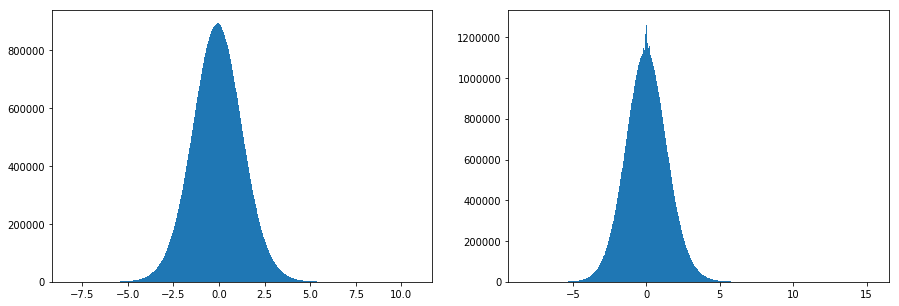

In [114]:
import matplotlib.pyplot as plt
%matplotlib inline
fix, ax = plt.subplots(1,2, figsize = (15,5))
for i, z in enumerate(single_trial_zscores):
    ax[i].hist(z.flatten(), bins = 1000)
    print(np.mean(z))
    print(np.std(z))

In [110]:
np.mean([1.3808475495685615,1.416332474835827])

1.3985900122021944

In [24]:
for sub_idx,sub in enumerate(subjects):
    imgs, events, conf, mask, json = enc.load_and_create_obj(sub,task,space,
                                                             mask='brain',
                                                             skip_missing=True)
    print(np.sum(nib.load(mask).get_data()))

('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-3_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-3_events.tsv, '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-3_desc-confounds_regressors.tsv')
('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-4_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-4_events.tsv, '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-4_desc-confounds_regressors.tsv')
('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-04/ses-face1/func/sub-04_ses-face1_task-expressive_run-5_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/

('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-13/ses-face1/func/sub-13_ses-face1_task-expressive_run-6_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/sub-13/ses-face1/func/sub-13_ses-face1_task-expressive_run-6_events.tsv, '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-13/ses-face1/func/sub-13_ses-face1_task-expressive_run-6_desc-confounds_regressors.tsv')
('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-13/ses-face1/func/sub-13_ses-face1_task-expressive_run-7_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/sub-13/ses-face1/func/sub-13_ses-face1_task-expressive_run-7_events.tsv, '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-13/ses-face1/func/sub-13_ses-face1_task-expressive_run-7_desc-confounds_regressors.tsv')
('loading files '
 '/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-13/ses-face1/func/sub-13_ses-face1_task-expressive_run-8_space-T1w_desc-preproc_bold.nii.gz, '
 '/srv/FEED/mri_data/bids/

In [27]:
(249140 + 252233)/2

250686.5

In [74]:
np.max(single_trial_zscores[1])

10.742454275486855

In [65]:
img = unmask(avg_zscore, model.mask_img)

In [70]:
np.max(img.get_data())

0.8257993647002101

In [56]:
model.mask_img

'/srv/FEED/mri_data/bids/derivatives/fmriprep/sub-13/ses-face1/func/sub-13_ses-face1_task-expressive_run-1_space-T1w_desc-brain_mask.nii.gz'

In [62]:
z_array_all.

(23, 29, 252233)

In [71]:
from nistats.thresholding import fdr_threshold
fdr_threshold(img.get_data(), alpha = 0.05)

ValueError: operands could not be broadcast together with shapes (81,103,78) (81,) 